In [1]:
import warnings

warnings.filterwarnings('ignore')

# On the morphological composition of cities and how to measure it

## Martin Fleischmann

22 September 2020, GeoPython

### Jupyter notebook

[https://github.com/martinfleis/talks](https://github.com/martinfleis/talks)

## Martin Fleischmann
<div style='float: right'><img src="figures/mugshot.jpg" width=900px></div>

Geographic Data Science Lab, University of Liverpool

[@martinfleis](https://twitter.com/martinfleis)

[martinfleischmann.net](https:martinfleischmann.net)

martin@martinfleischmann.net

<center><img src="figures/gdsl.png"  style="width:50%"><center>

<center><img src="https://github.com/geopandas/geopandas/raw/master/doc/source/_static/logo/geopandas_logo.svg"  style="width:50%"><center>

<center><img src="https://pysal.org/assets/pysal_nav_logo.svg" style="width:40%"></center>

<center><img src="https://raw.githubusercontent.com/martinfleis/momepy/master/docs/_static/logo.svg" style="width:40%"><center>

## What do you mean by morphological composition?

<center><img src="figures/prague_jay_danntine.jpg"><center>

<center><img src="figures/paris_george_kantarzis.jpg"><center>

<center><img src="figures/ny_anuj_gogari.jpg"><center>

<center><img src="figures/tokyo_masaaki_komori.jpg"><center>

<center><img src="figures/town_stephen_oliver.jpg"><center>

<center><img src="figures/sao_paulo_jonathan_borba.jpg"><center>

<center><img src="figures/sao_paulo.jpg"><center>

<center><img src="figures/barcelona.jpg"><center>

<center><img src="figures/brasilia.jpg"><center>

<center><img src="figures/atlanta.jpg"><center>

## How do I capture that?

<center><img src="figures/track.jpg"><center>

<center><img src="figures/elements.png"><center>

### Streets + Buildings

### ~Plots~

### Get some data

Getting OpenStreetMap data using `osmnx` by Geoff Boeing.

In [2]:
import osmnx

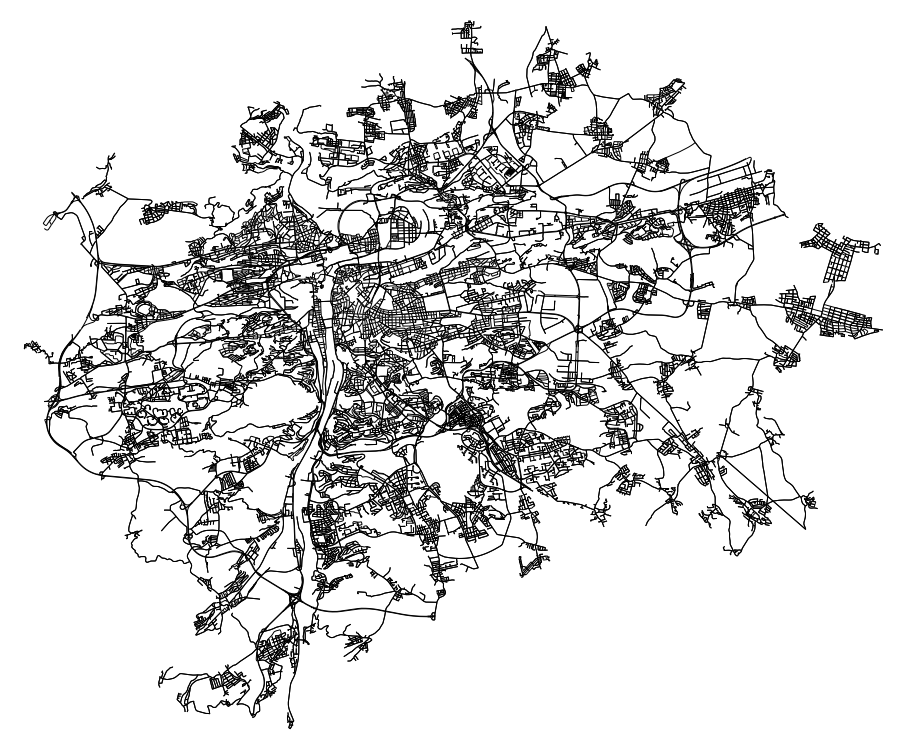

In [3]:
# specify center point and distance
G = osmnx.graph_from_place('Prague', network_type='drive')
fig, ax = osmnx.plot_graph(G, node_size=0, bgcolor='white', edge_color='black', figsize=(16, 16))

In [4]:
# save data to GeoPandas GeoDataFrames
nodes, edges = osmnx.graph_to_gdfs(G)

Getting OpenStreetMap data using `pyrosm` by Henrikki Tenkanen.

In [31]:
import pyrosm

In [32]:
# Dowload data for Prague
data_file = pyrosm.get_data('prag')

Downloaded Protobuf data 'Prag.osm.pbf' (35.95 MB) to:
'/var/folders/kp/fxnnw89x5qbb9gryn507p03c0000gn/T/pyrosm/Prag.osm.pbf'


In [33]:
# Initialize the OSM object
osm = pyrosm.OSM(data_file)

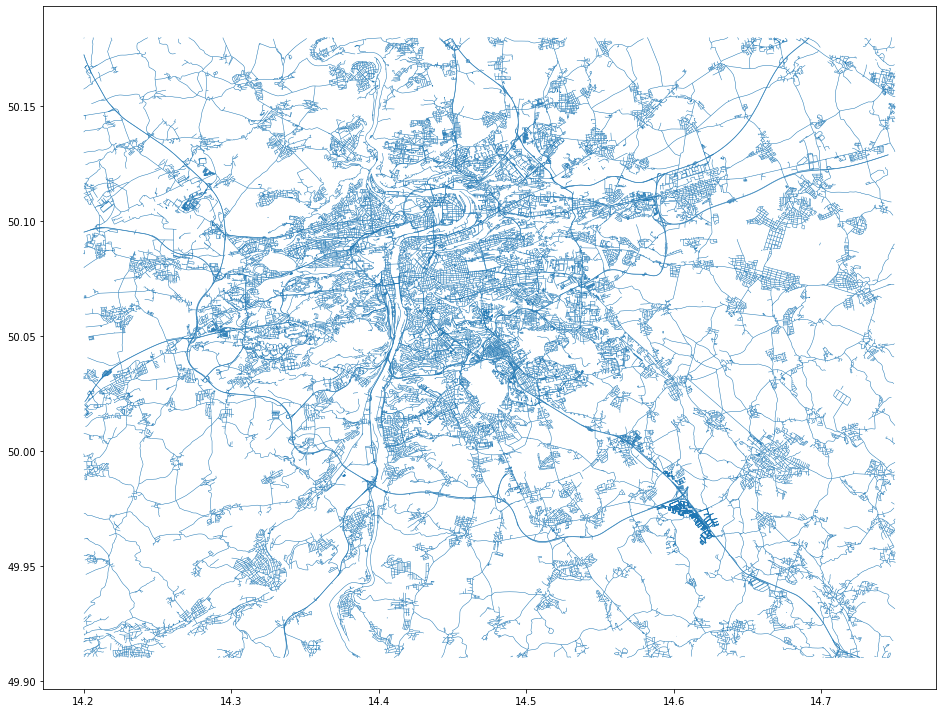

In [36]:
streets = osm.get_network(network_type="driving")
streets.plot(linewidth=0.5, figsize=(16, 16))

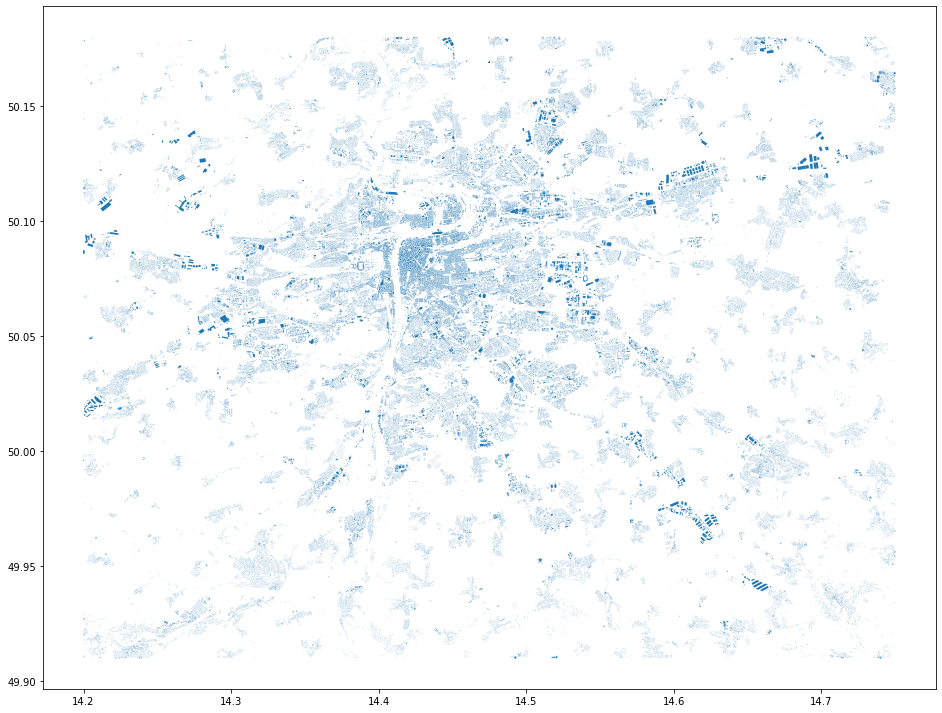

In [34]:
buildings = osm.get_buildings()
buildings.plot(figsize=(16, 16))

Getting a small sample

In [37]:
sample_buildings = buildings.cx[14.375:14.475, 50.07:50.14].to_crs(epsg=5514)
sample_streets = streets.cx[14.375:14.475, 50.07:50.14].to_crs(epsg=5514)

In [12]:
import matplotlib.pyplot as plt
import contextily

<AxesSubplot:>

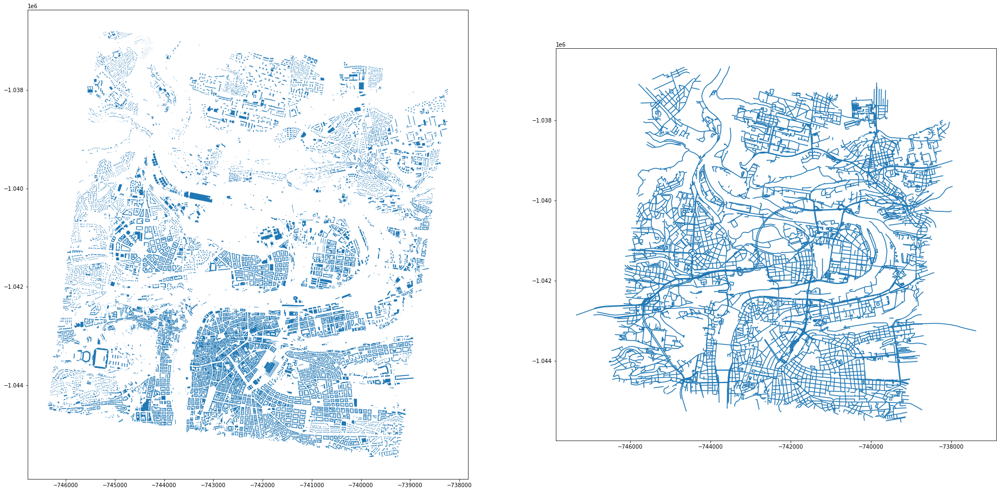

In [12]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot(ax=axs[0])
sample_streets.plot(ax=axs[1])

## Let's measure!

Wait! We should clean the data first.

## Clean the data

MultiPolygons do not make sense as building footprints.

In [13]:
sample_buildings = sample_buildings.explode()

In [14]:
sample_buildings.type.value_counts()

Polygon       30926
LineString        2
dtype: int64

Neither do LineStrings :).

In [15]:
sample_buildings = sample_buildings[sample_buildings.type == 'Polygon']

Make sure your geometries are valid.

In [16]:
sample_buildings.is_valid.all()

False

In [17]:
sample_buildings.geometry = sample_buildings.buffer(0)

In [18]:
sample_buildings.is_valid.all()

True

Further issues? `momepy` can help.

In [8]:
import momepy

In [20]:
sample_buildings = momepy.preprocess(sample_buildings, compactness=None, loops=1, verbose=False)

## Let's measure!

dimension | shape | spatial distribution

intensity | connectivity | diversity

We can measure from the scale of individual features to metropolitan areas.

Measuring dimensions using `geopandas`.

In [21]:
sample_buildings['area'] = sample_buildings.area
sample_streets['length'] = sample_streets.length

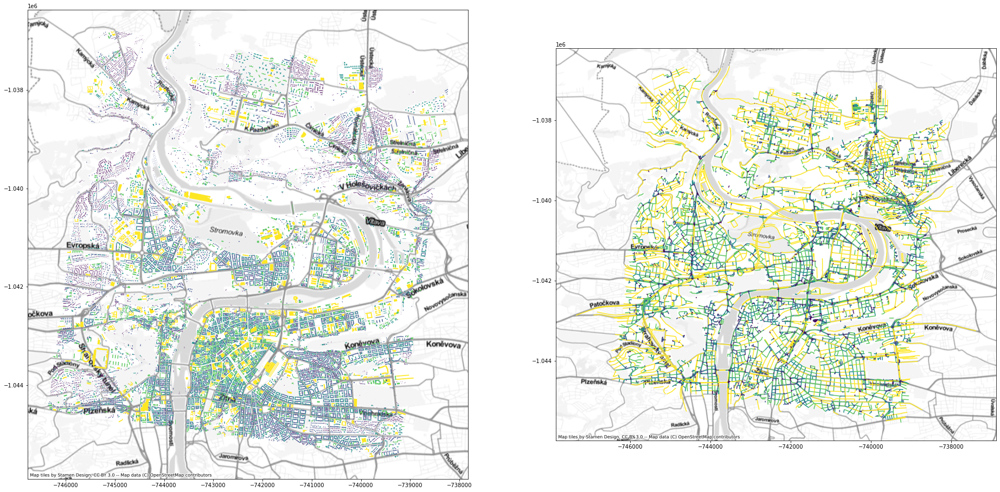

In [22]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot('area', ax=axs[0], scheme='JenksCaspallSampled')
sample_streets.plot('length', ax=axs[1], scheme='JenksCaspallSampled')
contextily.add_basemap(ax=axs[0], crs=sample_buildings.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=sample_streets.crs, source=contextily.providers.Stamen.TonerLite)

Measuring shapes of features using `momepy`.

In [39]:
sample_buildings['eri'] = momepy.EquivalentRectangularIndex(sample_buildings).series
sample_streets['linearity'] = momepy.Linearity(sample_streets).series

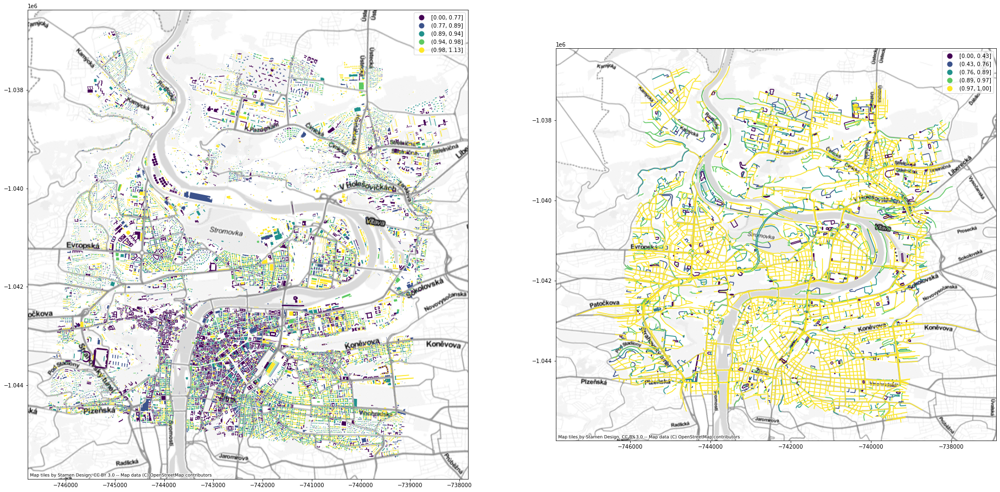

In [45]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot('eri', ax=axs[0], scheme='JenksCaspallSampled', legend=True)
sample_streets.plot('linearity', ax=axs[1], scheme='JenksCaspallSampled', legend=True)
contextily.add_basemap(ax=axs[0], crs=sample_buildings.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=sample_streets.crs, source=contextily.providers.Stamen.TonerLite)

## What about a spatial unit?

### Here comes morphological tessellation

In [23]:
import geopandas as gpd

In [24]:
bubenec_blg = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='buildings')
bubenec_tess = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='tessellation')

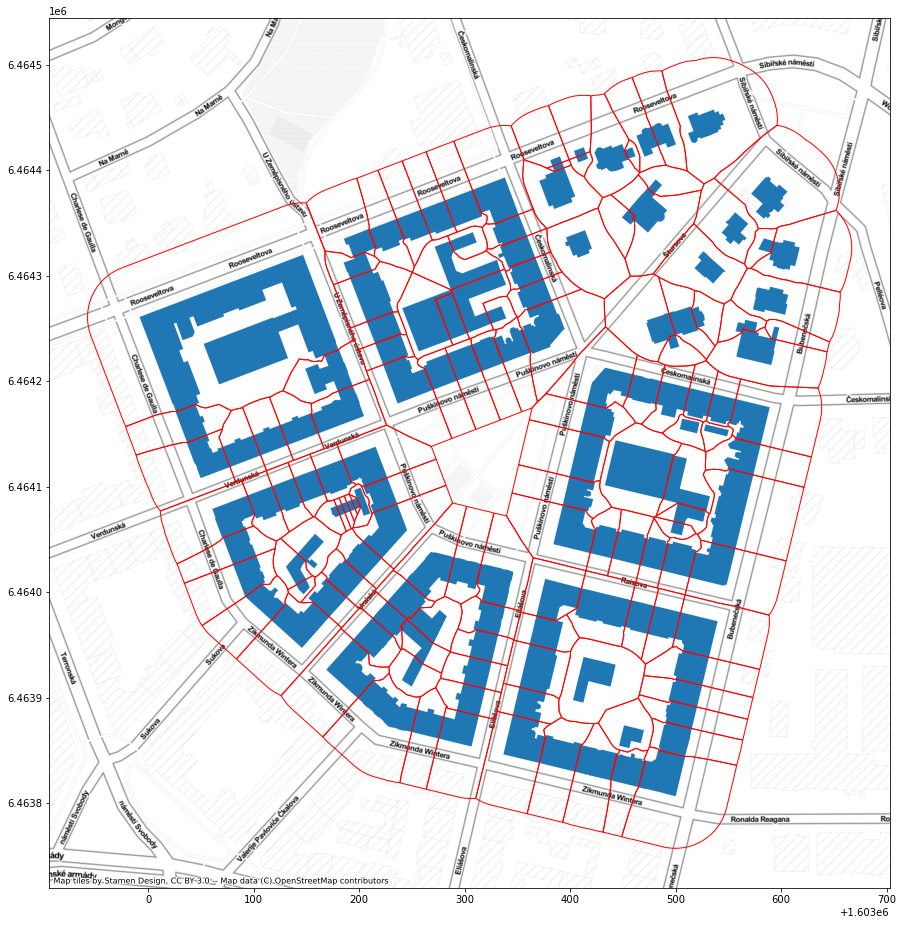

In [25]:
ax = bubenec_blg.plot(figsize=(16, 16))
bubenec_tess.plot(ax=ax, facecolor='none', edgecolor='r')
contextily.add_basemap(ax=ax, crs=bubenec_tess.crs, source=contextily.providers.Stamen.TonerLite)

Generate morpohological tessellation for our sample data.

In [26]:
sample_buildings['uID'] = range(len(sample_buildings))

In [ ]:
limit = momepy.buffered_limit(sample_buildings)

In [27]:
tess = momepy.Tessellation(sample_buildings, unique_id='uID', limit=limit, verbose=False)

In [28]:
sample_tessellation = tess.tessellation

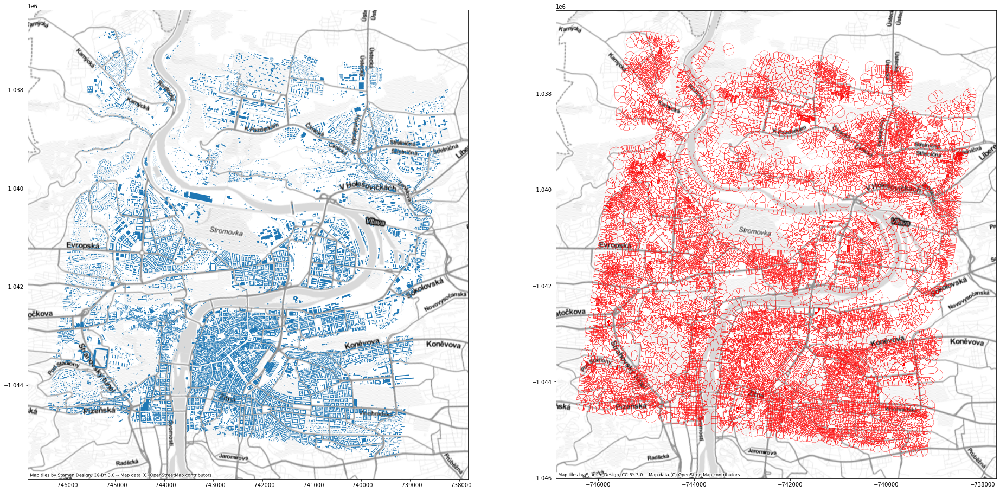

In [29]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_buildings.plot(ax=axs[0])
sample_tessellation.plot(ax=axs[1], facecolor='none', edgecolor='r', linewidth=.4)
contextily.add_basemap(ax=axs[0], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

How big part of a tessellation cell is covered by a building?

In [30]:
sample_tessellation['covered_area_ratio'] = momepy.AreaRatio(sample_tessellation, 
                                                             sample_buildings, 
                                                             left_areas=sample_tessellation.area, 
                                                             right_areas='area', 
                                                             unique_id='uID').series

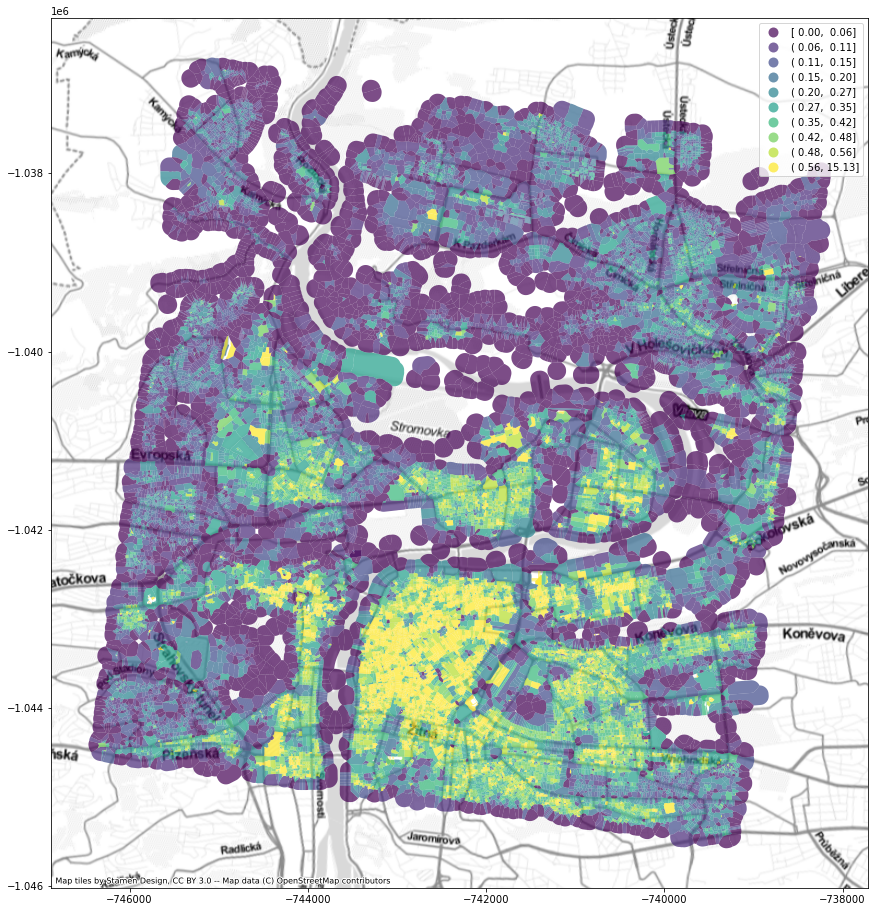

In [31]:
ax = sample_tessellation.plot('covered_area_ratio', figsize=(16, 16), scheme='Quantiles', k=10, legend=True, alpha=.7)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

Measuring contextual relations.

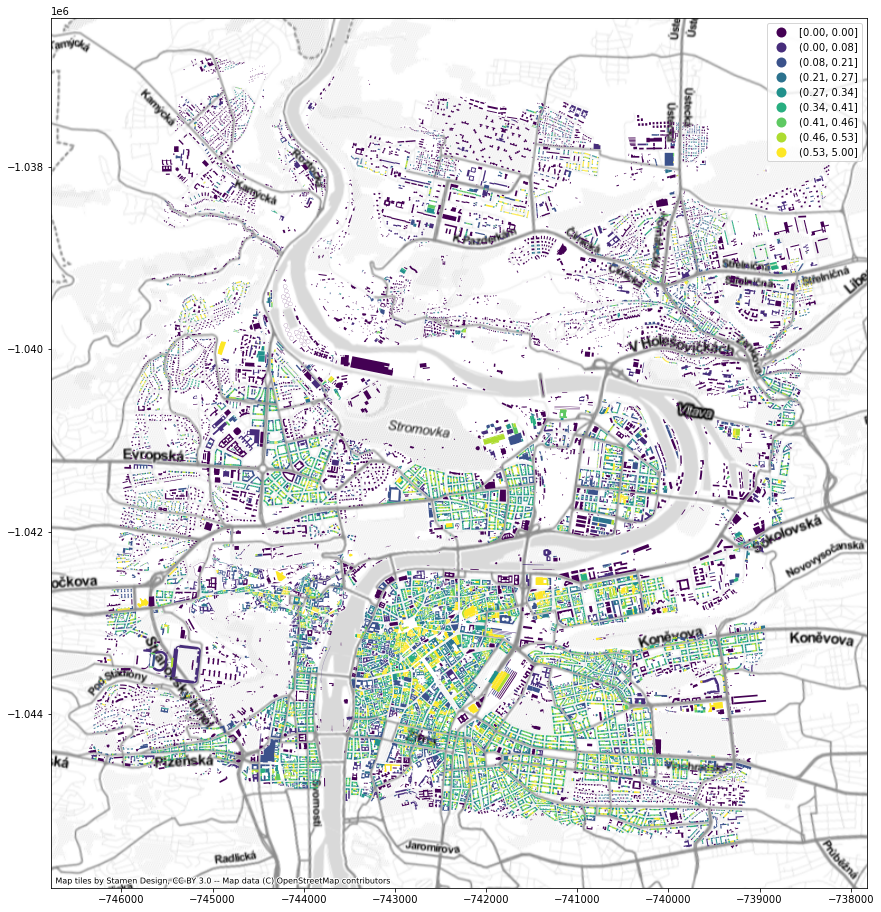

In [32]:
sample_buildings['shared_walls_ratio'] = momepy.SharedWallsRatio(sample_buildings).series
ax = sample_buildings.plot('shared_walls_ratio', figsize=(16, 16), legend=True, scheme='quantiles', k=10)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

Using spatial weights derived from tessellation.

In [33]:
import libpysal

In [34]:
w = libpysal.weights.Queen.from_dataframe(bubenec_tess)

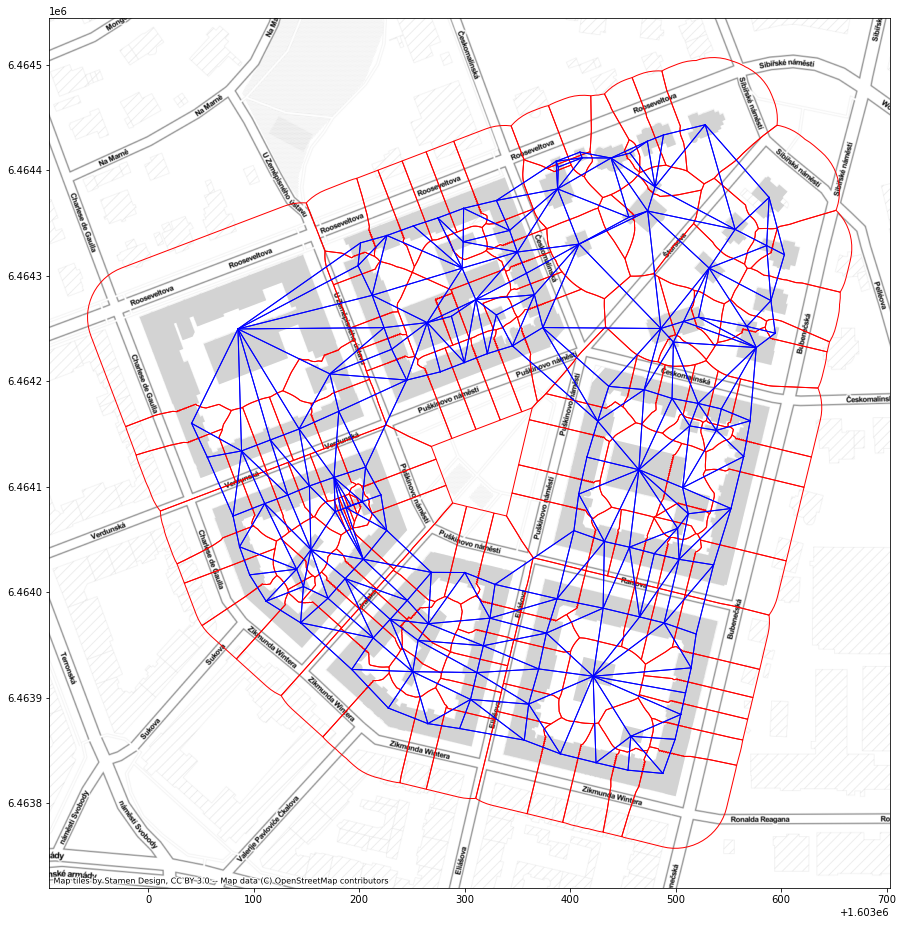

In [35]:
ax = bubenec_blg.plot(figsize=(16, 16), color='lightgrey')
bubenec_tess.plot(ax=ax, facecolor='none', edgecolor='r')
w.plot(bubenec_blg, ax=ax, 
        edge_kws=dict(color='b', linewidth=1),
        node_kws=dict(marker=''))
contextily.add_basemap(ax=ax, crs=bubenec_tess.crs, source=contextily.providers.Stamen.TonerLite)

In [36]:
sample_weights = libpysal.weights.Queen.from_dataframe(sample_tessellation, ids='uID')

100%|██████████| 27498/27498 [00:56<00:00, 484.90it/s]


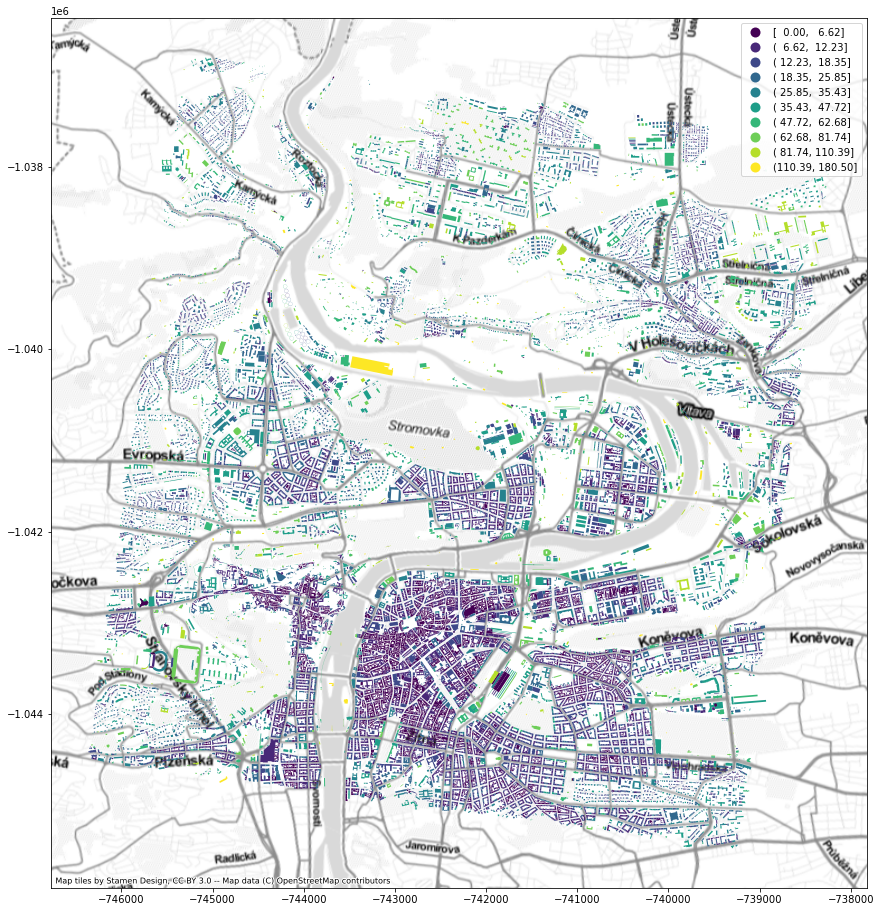

In [37]:
sample_buildings['neighbour_dist'] = momepy.NeighborDistance(sample_buildings, sample_weights, 'uID').series
ax = sample_buildings.plot('neighbour_dist', figsize=(16, 16), legend=True, scheme='naturalbreaks', k=10)
contextily.add_basemap(ax=ax, crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

Using higher order spatial weights.

In [38]:
sw3 = momepy.sw_high(k=3, weights=sample_weights)

In [39]:
avg_area = momepy.AverageCharacter(
    sample_tessellation, sample_tessellation.area, spatial_weights=sw3, unique_id='uID')
sample_tessellation['mean_area'] = avg_area.mean
sample_tessellation['median_area'] = avg_area.median

100%|██████████| 27451/27451 [00:37<00:00, 726.57it/s]


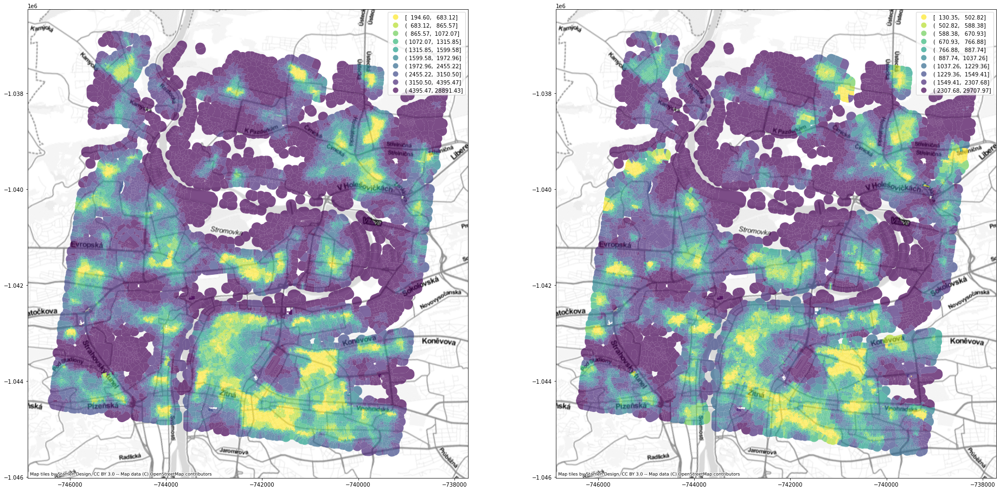

In [40]:
fig, axs = plt.subplots(1, 2, figsize=(32, 16))
sample_tessellation.plot('mean_area', ax=axs[0], scheme='quantiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
sample_tessellation.plot('median_area', ax=axs[1], scheme='quantiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=sample_tessellation.crs, source=contextily.providers.Stamen.TonerLite)

## Network analysis

Analysing network as a whole using `osmnx`.

In [41]:
G

In [42]:
place = 'Prague, Czechia'
gdf = osmnx.geocode_to_gdf(place)
area = osmnx.project_gdf(gdf).unary_union.area

stats = osmnx.basic_stats(G, area=area)

In [43]:
stats

{'n': 20880,
 'm': 48501,
 'k_avg': 4.645689655172414,
 'intersection_count': 17224,
 'streets_per_node_avg': 2.8129310344827587,
 'streets_per_node_counts': {0: 0,
  1: 3656,
  2: 460,
  3: 13059,
  4: 3561,
  5: 128,
  6: 15,
  7: 1},
 'streets_per_node_proportion': {0: 0.0,
  1: 0.17509578544061302,
  2: 0.022030651340996167,
  3: 0.6254310344827586,
  4: 0.17054597701149427,
  5: 0.006130268199233717,
  6: 0.0007183908045977011,
  7: 4.789272030651341e-05},
 'edge_length_total': 5787940.486999998,
 'edge_length_avg': 119.33651856662745,
 'street_length_total': 3579018.3410000047,
 'street_length_avg': 121.87626305932046,
 'street_segments_count': 29366,
 'node_density_km': 42.10617818925434,
 'intersection_density_km': 34.733563847304445,
 'edge_density_km': 11671.841642453135,
 'street_density_km': 7217.37471306301,
 'circuity_avg': 1.0666995535490493,
 'self_loop_proportion': 0.003381373579926187,
 'clean_intersection_count': None,
 'clean_intersection_density_km': None}

Analysing local nature of networks using `momepy`.

In [9]:
graph = momepy.gdf_to_nx(sample_streets)

In [16]:
graph = momepy.meshedness(graph, radius=5, name='meshedness')
graph = momepy.node_degree(graph, name='degree')
graph = momepy.proportion(graph, radius=800, distance='mm_len', four='fourway', degree='degree')

100%|██████████| 10783/10783 [00:28<00:00, 372.23it/s]


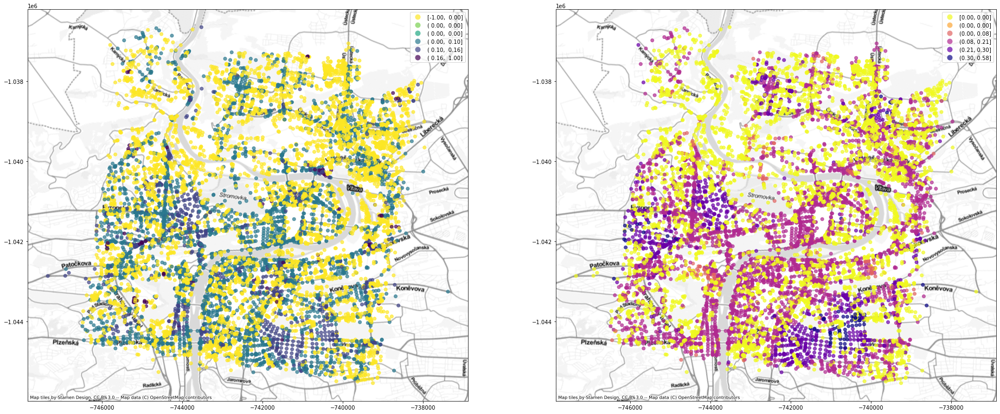

In [23]:
nodes = momepy.nx_to_gdf(graph, points=True, lines=False, spatial_weights=False)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('meshedness', ax=axs[0], scheme='percentiles', k=10, cmap='viridis_r', legend=True, alpha=.7)
nodes.plot('fourway', ax=axs[1], scheme='percentiles', k=10, cmap='plasma_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

In [47]:
graph = momepy.closeness_centrality(graph, radius=400, name='closeness400', distance='mm_len', weight='mm_len')
graph = momepy.closeness_centrality(graph, name='closeness_global', weight='mm_len')

100%|██████████| 10792/10792 [00:18<00:00, 594.32it/s] 


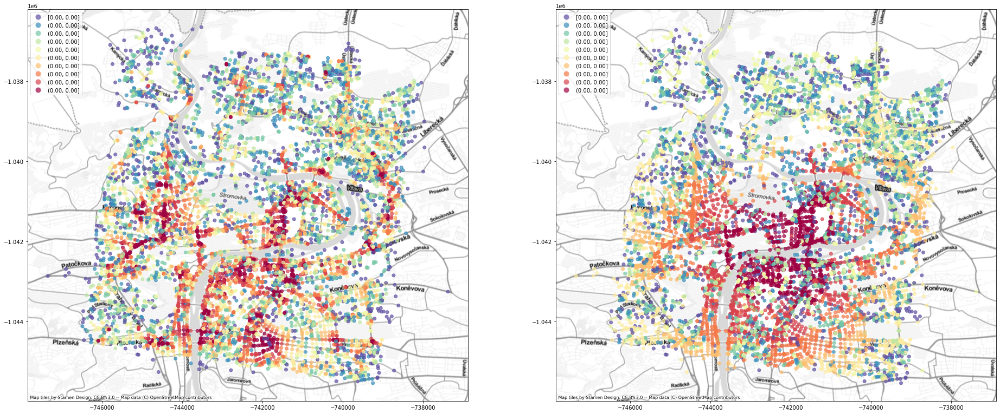

In [48]:
nodes = momepy.nx_to_gdf(graph, lines=False)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('closeness400', ax=axs[0], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
nodes.plot('closeness_global', ax=axs[1], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

In [49]:
graph = momepy.betweenness_centrality(graph, name='betweenness_metric_n', mode='nodes', weight='mm_len')
graph = momepy.betweenness_centrality(graph, name='betweenness_metric_e', mode='edges', weight='mm_len')

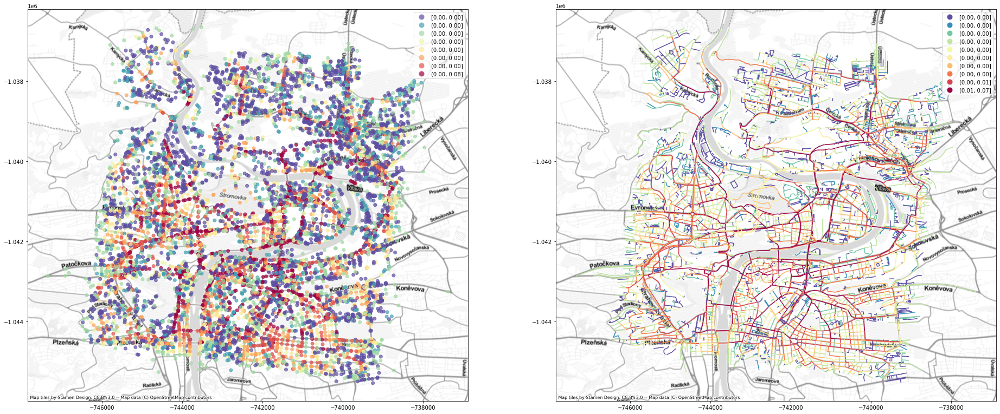

In [50]:
nodes, edges = momepy.nx_to_gdf(graph)

fig, axs = plt.subplots(1, 2, figsize=(32, 16))
nodes.plot('betweenness_metric_n', ax=axs[0], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=.7)
edges.plot('betweenness_metric_e', ax=axs[1], scheme='quantiles', k=10, cmap='Spectral_r', legend=True, alpha=1)
contextily.add_basemap(ax=axs[0], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)
contextily.add_basemap(ax=axs[1], crs=nodes.crs, source=contextily.providers.Stamen.TonerLite)

## What can I do with it?

Measure a complex set of 74 characters.

<center style="padding: 0 5% 0 5%"><img src="figures/swr.png" width=40% style="float: left"><img src="figures/ints.png" width=40% style="float: right"><center>

Measure their contextual (spatially lagged) representation.

<center><img src="figures/lagged.png"><center>

### Automatic identification of urban types

Using Gaussian Mixture Model clustering and Bayesian information criterion.

On input we have 296 contextual characters (74 x 4).

```python
from sklearn.mixture import GaussianMixture
```

```python
for n in range(1, 40):
    gmm = GaussianMixture(
        n_components=n, 
        covariance_type="full")
    fitted = gmm.fit(data)
    bicnum = gmm.bic(data)
```

```python
from seaborn import lineplot

fig, ax = plt.subplots(figsize=(8, 8))
lineplot(ax=ax, x="n", y="bic", data=bic)
sns.despine(offset=10)
plt.axhline(2.026849e+07, color='r')
plt.xlabel('number of components')
plt.ylabel('BIC score')
```

<img src="figures/complete_bic.png" width=35%>

```python
n = 20

gmm = GaussianMixture(n_components=n, 
                      covariance_type="full", 
                      max_iter=200, 
                      n_init=5)
fitted = gmm.fit(data)
```

```python
data['cluster'] = gmm.predict(data)
```

<center><img src="figures/PRG_clusters.png"><center>

<center><img src="figures/PRG_clusters_detail.png" width=1100px><center>

### Hierarchical clustering

Using Ward's algorithm.

```python
from scipy.cluster import hierarchy

group = data.groupby('cluster').mean()
Z = hierarchy.linkage(group, 'ward')
```

```python
dn = hierarchy.dendrogram(Z, labels=group.index)
```

<center><img src="figures/dendrogram.png" width=50%><center>

<center><img src="figures/PRG_hierarchical_clusters.png"><center>

```python

import momepy
import geopandas
```

## Martin Fleischmann

### Jupyter notebook

[https://github.com/martinfleis/talks](https://github.com/martinfleis/talks)

### Contact
    
[@martinfleis](https://twitter.com/martinfleis) (GitHub, Twitter)

[martinfleischmann.net](https:martinfleischmann.net)

martin@martinfleischmann.net

In [51]:
print('Thank you!')

Thank you!
